In [1]:
!conda info --envs


# conda environments:
#
                         /Users/mmckay/.julia/conda/3
base                     /Users/mmckay/conda
AstronomicalData         /Users/mmckay/conda/envs/AstronomicalData
astroconda               /Users/mmckay/conda/envs/astroconda
astroconda27             /Users/mmckay/conda/envs/astroconda27
astroconda37             /Users/mmckay/conda/envs/astroconda37
marvin_env               /Users/mmckay/conda/envs/marvin_env
marvin_v2             *  /Users/mmckay/conda/envs/marvin_v2
ztf_alert_env            /Users/mmckay/conda/envs/ztf_alert_env



In [2]:
import numpy as np
from astropy.io import fits
from marvin.tools.maps import Maps
from marvin.tools.image import Image
import matplotlib.pyplot as plt
from astropy.cosmology import FlatLambdaCDM
import astropy.units as u
import plotly.express as px
import plotly.graph_objects as go
plt.style.use('seaborn-dark')
import glob
import pandas as pd
import seaborn as sns

INFO: No release version set. Setting default to DR15
[WARNING]: unclosed file <_io.TextIOWrapper name='/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/marvin/extern/tree/python/tree/etc/tree.yml' mode='r' encoding='US-ASCII'> (ResourceWarning)
[WARNING]: unclosed file <_io.TextIOWrapper name='/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/marvin/extern/sdss_access/python/sdss_access/etc/sdss_access.yml' mode='r' encoding='US-ASCII'> (ResourceWarning)
[WARNING]: path /Users/mmckay/sas/dr15/manga/spectro/analysis/v2_4_3/2.2.1/dapall-v2_4_3-2.2.1.fits cannot be found. Setting dapall to None. (MarvinUserWarning)
[WARNING]: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject (RuntimeWarning)
[WARNING]: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject (RuntimeWarning)
[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/importlib/

# Read in IFU .csv files

In [3]:
lg12_ifu_df = pd.read_csv('/Users/mmckay/Desktop/research/FMR_MZR/lg12_result_fits/lg12_mastertable.csv', delimiter=',')

bbrd_ifu_df = pd.read_csv('/Users/mmckay/Desktop/research/FMR_MZR/bbrd_result_fits/bbrd_mastertable.csv', delimiter=',')

In [4]:
# Read in Global star forming LG12 and BBRD .csv file
## - Global BPT AGN classification were already removed perviously

In [5]:
lg12_global_df = pd.read_csv('/Users/mmckay/Desktop/research/FMR_MZR/lg12_sf_reduced.csv')
#lg12_global_df.head()

bbrd_global_df = pd.read_csv('/Users/mmckay/Desktop/research/FMR_MZR/bbrd_sf_reduced.csv')

In [6]:
# We have a lot of inf values due to division by zero - should remove values entirely
pd.set_option('use_inf_as_na', True) # compute inf values as nans

In [7]:
lg12_ifu_df.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'HALPHA', 'HALPHA KCORR', 'HBETA KCORR',
       'NII6585 KCORR', 'OII3727 KCORR', 'OII3729 KCORR', 'OIII5008 KCORR',
       'SII6718 KCORR', 'SII6732 KCORR', 'HALPHA SNR', 'HBETA SNR',
       'NII6585 SNR', 'OII3727 SNR', 'OII3729 SNR', 'OIII5008 SNR',
       'SII6718 SNR', 'SII6732 SNR', 'HALPHA ERROR', 'HBETA ERROR',
       'NII6585 ERROR', 'OII3727 ERROR', 'OII3729 ERROR', 'OIII5008 ERROR',
       'SII6718 ERROR', 'SII6732 ERROR', 'R-BAND SNR', 'HA/HB', 'HA LUM',
       'SFR', 'SFR DENSITY', 'ELLIP R', 'R/REFF', 'LOG(O/H)+12_[N2O2]',
       'LOG(O/H)+12_[O3N2]', 'LOG(O/H)+12_[N2]', 'GYR_LW', 'GYR_MW', 'GYR_ERR',
       'SP_ZSUBL', 'SP_ZSUBM', 'SP_ZERR', 'VEL_KM/S', 'VEL_ERR]', 'VDISP_KM/S',
       'VDISP_ERR', 'M/L', 'MSUN/SPX2', 'MSUN/ARCS2', 'MSUN/KPC2', 'D4000',
       'D4000_ERR', 'HDELTA', 'HDELTA_ERR', 'O3HB_RATIO', 'N2HA_RATIO',
       'BPT CLASS', 'B20 DELTASFR'],
      dtype='object')

In [8]:
bbrd_global_df.columns

Index(['Unnamed: 0', 'RASDSSinfo', 'DecSDSSinfo', 'zSDSSinfo',
       'HalphaSDSSline [1e-17*erg/cm^2/s]',
       'OIII5007SDSSline [1e-17*erg/cm^2/s]',
       'OIII4959SDSSline [1e-17*erg/cm^2/s]',
       'HbetaSDSSline [1e-17*erg/cm^2/s]', 'HdeltaSDSSline [1e-17*erg/cm^2/s]',
       'N6583SDSS [1e-17*erg/cm^2/s]', 'S6717SDSSline [1e-17*erg/cm^2/s]',
       'S6731SDSSline [1e-17*erg/cm^2/s]',
       'OII3726SDSSline [1e-17*erg/cm^2/s]',
       'OII3729SDSSline [1e-17*erg/cm^2/s]',
       'OI6300SDSSline [1e-17*erg/cm^2/s]', 'HalphaSDSSline_ERR',
       'OIII5007SDSSline_ERR', 'OIII4959SDSSline_ERR', 'HbetaSDSSline_ERR',
       'HdeltaSDSSline_ERR', 'N6583SDSS_ERR', 'S6717SDSSline_ERR',
       'S6731SDSSline_ERR', 'OII3726SDSSline_ERR', 'OII3729SDSSline_ERR',
       'OI6300SDSSline_ERR', 'Dn4000SDSSindx', 'petroRad', 'petroRadE',
       'petroR50', 'petroR50E', 'petroR90', 'petroR90E',
       'Metallicity_med(T04)', 'Metallicity_avg(T04)', 'Mstaravg_SDSStotlgm',
       'Mstarmed_SDSSto

# Data Preprocessing
## - Replace/remove inf,-inf, invalid values
## - Remove AGN BPT class galaxies and spaxels
## - Remove Halpha SNR < 3
## - Remove spaxels with large errors

In [9]:
# Replace inf, -inf values to nan values 
lg12_ifu_df = lg12_ifu_df.replace([np.inf, -np.inf], np.nan)
bbrd_ifu_df = bbrd_ifu_df.replace([np.inf, -np.inf], np.nan)

# - Remove AGN BPT class spaxels
- SDSS galaxies that calssified as AGN were removed prior to dataframe creation. See generate_manga_maps.ipynd (1/28/21)

In [10]:
lg12_ifu_df['BPT CLASS'].describe()

count    146564.000000
mean          0.483338
std           0.796453
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           5.000000
Name: BPT CLASS, dtype: float64

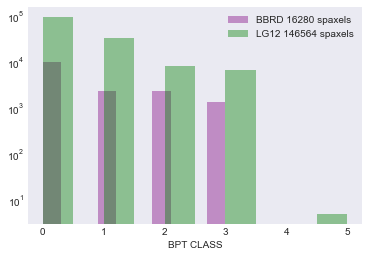

In [11]:
sns.distplot(bbrd_ifu_df['BPT CLASS'], bins=10, kde=False, color='purple', label='BBRD {} spaxels'.format(bbrd_ifu_df['BPT CLASS'].count()))
sns.distplot(lg12_ifu_df['BPT CLASS'], bins=10, kde=False, color= 'green', label='LG12 {} spaxels'.format(lg12_ifu_df['BPT CLASS'].count()))
plt.yscale('log')
plt.legend()



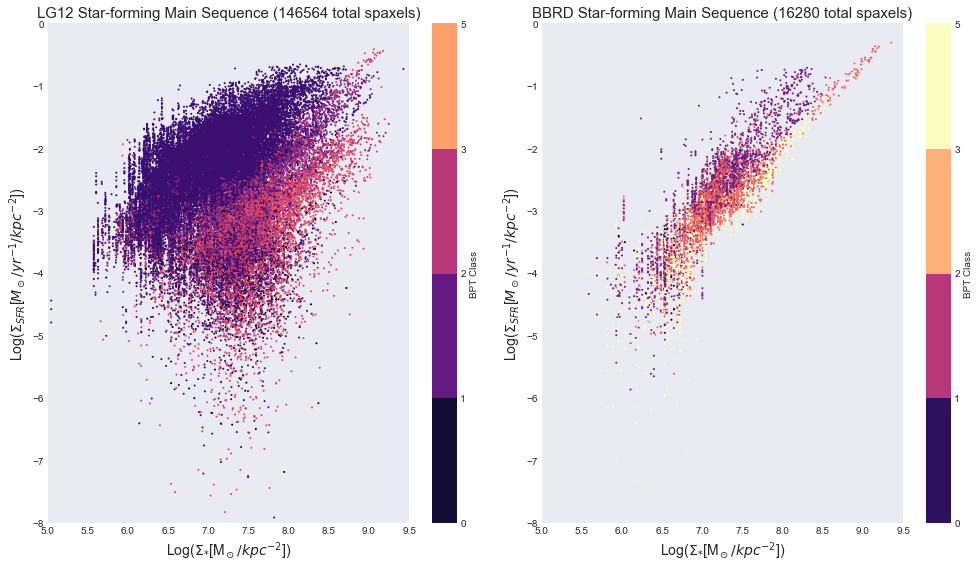

In [12]:
fig, (ax1,ax2) = plt.subplots(1, 2, figsize=(14, 8))
# im1 = ax1.scatter(lg12_ifu_df['MSUN/SPX2'], lg12_ifu_df['SFR DENSITY'], s=1, c=lg12_ifu_df['BPT CLASS'], cmap=plt.cm.get_cmap('plasma', 5))
im1 = ax1.scatter(lg12_ifu_df['MSUN/SPX2'], lg12_ifu_df['SFR DENSITY'], s=1, c=lg12_ifu_df['BPT CLASS'], cmap='magma')
fig.colorbar(im1, ax=ax1, label='BPT Class', orientation='vertical', spacing='uniform', boundaries=[0,1,2,3,5])
ax1.set_xlim(5,9.5)
ax1.set_ylim(-8,0)
ax1.set_title('LG12 Star-forming Main Sequence ({} total spaxels)'.format(lg12_ifu_df['BPT CLASS'].count()), fontsize=15)
ax1.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
ax1.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)

im2 = ax2.scatter(bbrd_ifu_df['MSUN/SPX2'], bbrd_ifu_df['SFR DENSITY'], s=1, c=bbrd_ifu_df['BPT CLASS'], cmap='magma')
fig.colorbar(im2, ax=ax2, label='BPT Class', orientation='vertical', spacing='uniform', boundaries=[0,1,2,3,5])
ax2.set_xlim(5,9.5)
ax2.set_ylim(-8,0)
ax2.set_title('BBRD Star-forming Main Sequence ({} total spaxels)'.format(bbrd_ifu_df['BPT CLASS'].count()), fontsize=15)
ax2.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
ax2.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)
fig.tight_layout()
#plt.show(show=False)

# After BPT AGN class spaxels are removed 

In [13]:
# Mask all spaxels with a BPT class > 2 where 0=None, 1=SF class, 2=composite class, 3=AGN and 4,5=ambiguous
# LG12
lg12_bpt_agn_mask = lg12_ifu_df['BPT CLASS'] > 2.0 # Select spaxles that are > 2
lg12_bpt_zero_mask = lg12_ifu_df['BPT CLASS'] == 0.0 # Select spaxles that are > 0

# BBRD
bbrd_bpt_agn_mask = bbrd_ifu_df['BPT CLASS'] > 2.0 # Select spaxles that are > 2
bbrd_bpt_zero_mask = bbrd_ifu_df['BPT CLASS'] == 0.0 # Select spaxles that are > 0


# Apply Mask to original dataframe
lg12_sf_ifu_df = lg12_ifu_df[~lg12_bpt_agn_mask] # Select the None, SF and composoite spaxels
lg12_sf_ifu_df = lg12_sf_ifu_df[~lg12_bpt_zero_mask] # Select only the SF and composite spaxels 
print(lg12_sf_ifu_df['B20 DELTASFR'].describe())

# Apply Mask to original dataframe
bbrd_sf_ifu_df = bbrd_ifu_df[~bbrd_bpt_agn_mask] # Select the None, SF and composoite spaxels
bbrd_sf_ifu_df = bbrd_sf_ifu_df[~bbrd_bpt_zero_mask] # Select only the SF and composite spaxels
print(bbrd_sf_ifu_df['B20 DELTASFR'].describe())


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:13: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.


count    42677.000000
mean         0.664652
std          0.769034
min         -6.421977
25%          0.261268
50%          0.834404
75%          1.200446
max          6.126871
Name: B20 DELTASFR, dtype: float64
count    4776.000000
mean        0.312035
std         0.441761
min        -2.025773
25%         0.072309
50%         0.313488
75%         0.572252
max         2.433411
Name: B20 DELTASFR, dtype: float64


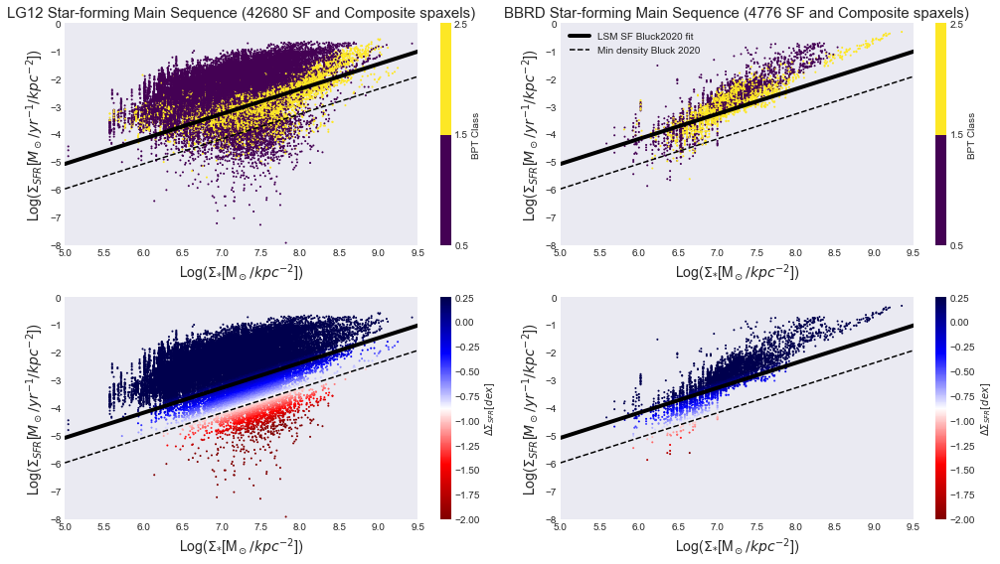

In [14]:
# Bluck et al 2020 LSM fit
logm_list = np.arange(5.0, 11.0, 0.1)
bluck_fit = 0.90 * logm_list - 9.57


fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2, 2, figsize=(14, 8))
im1 = ax1.scatter(lg12_sf_ifu_df['MSUN/SPX2'], lg12_sf_ifu_df['SFR DENSITY'], s=1, c=lg12_sf_ifu_df['BPT CLASS'], cmap='viridis')
ax1.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax1.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
fig.colorbar(im1, ax=ax1, label='BPT Class', orientation='vertical', spacing='uniform', boundaries=[0.5,1.5,2.5])
ax1.set_xlim(5,9.5)
ax1.set_ylim(-8,0)
ax1.set_title('LG12 Star-forming Main Sequence ({} SF and Composite spaxels)'.format(lg12_sf_ifu_df['BPT CLASS'].count()), fontsize=15)
ax1.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
ax1.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)


im2 = ax2.scatter(bbrd_sf_ifu_df['MSUN/SPX2'], bbrd_sf_ifu_df['SFR DENSITY'], s=1, c=bbrd_sf_ifu_df['BPT CLASS'], cmap='viridis')
ax2.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax2.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
fig.colorbar(im2, ax=ax2, label='BPT Class', orientation='vertical', spacing='uniform', boundaries=[0.5,1.5,2.5])
ax2.set_xlim(5,9.5)
ax2.set_ylim(-8,0)
ax2.set_title('BBRD Star-forming Main Sequence ({} SF and Composite spaxels)'.format(bbrd_sf_ifu_df['BPT CLASS'].count()), fontsize=15)
ax2.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
ax2.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)
ax2.legend()


im3 = ax3.scatter(lg12_sf_ifu_df['MSUN/SPX2'], lg12_sf_ifu_df['SFR DENSITY'], s=1, c=lg12_sf_ifu_df['B20 DELTASFR'], cmap='seismic_r', vmin=-2.0, vmax=0.25)
ax3.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax3.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
fig.colorbar(im3, ax=ax3, label=r'$\Delta \Sigma_{SFR}[dex]$', orientation='vertical')
ax3.set_xlim(5,9.5)
ax3.set_ylim(-8,0)
#ax3.set_title('LG12 Star-forming Main Sequence ({} SF and Composite spaxels)'.format(lg12_sf_ifu_df['BPT CLASS'].count()), fontsize=15)
ax3.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
ax3.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)


im4 = ax4.scatter(bbrd_sf_ifu_df['MSUN/SPX2'], bbrd_sf_ifu_df['SFR DENSITY'], s=1, c=bbrd_sf_ifu_df['B20 DELTASFR'], cmap='seismic_r', vmin=-2.0, vmax=0.25)
ax4.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax4.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
fig.colorbar(im4, ax=ax4, label=r'$\Delta \Sigma_{SFR}[dex]$', orientation='vertical')
ax4.set_xlim(5,9.5)
ax4.set_ylim(-8,0)
#ax4.set_title('BBRD Star-forming Main Sequence ({} SF and Composite spaxels)'.format(bbrd_sf_ifu_df['BPT CLASS'].count()), fontsize=15)
ax4.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
ax4.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)


fig.tight_layout()
plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/sfms_dsfr_bptclass.jpeg')
plt.show()

# Remove low and high outlier emission line SNR spaxels

In [15]:
lg12_sf_ifu_df.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'HALPHA', 'HALPHA KCORR', 'HBETA KCORR',
       'NII6585 KCORR', 'OII3727 KCORR', 'OII3729 KCORR', 'OIII5008 KCORR',
       'SII6718 KCORR', 'SII6732 KCORR', 'HALPHA SNR', 'HBETA SNR',
       'NII6585 SNR', 'OII3727 SNR', 'OII3729 SNR', 'OIII5008 SNR',
       'SII6718 SNR', 'SII6732 SNR', 'HALPHA ERROR', 'HBETA ERROR',
       'NII6585 ERROR', 'OII3727 ERROR', 'OII3729 ERROR', 'OIII5008 ERROR',
       'SII6718 ERROR', 'SII6732 ERROR', 'R-BAND SNR', 'HA/HB', 'HA LUM',
       'SFR', 'SFR DENSITY', 'ELLIP R', 'R/REFF', 'LOG(O/H)+12_[N2O2]',
       'LOG(O/H)+12_[O3N2]', 'LOG(O/H)+12_[N2]', 'GYR_LW', 'GYR_MW', 'GYR_ERR',
       'SP_ZSUBL', 'SP_ZSUBM', 'SP_ZERR', 'VEL_KM/S', 'VEL_ERR]', 'VDISP_KM/S',
       'VDISP_ERR', 'M/L', 'MSUN/SPX2', 'MSUN/ARCS2', 'MSUN/KPC2', 'D4000',
       'D4000_ERR', 'HDELTA', 'HDELTA_ERR', 'O3HB_RATIO', 'N2HA_RATIO',
       'BPT CLASS', 'B20 DELTASFR'],
      dtype='object')

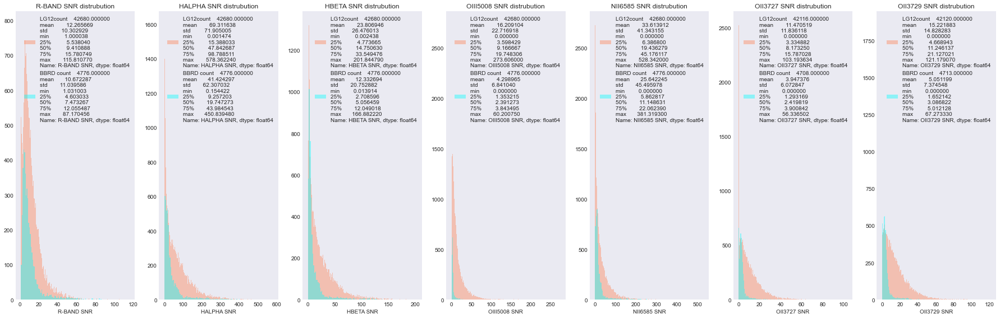

In [16]:
# Plot distrubution of SNR column before applying cuts
#print(lg12_sf_ifu_df['R-BAND SNR'].describe())
#print(bbrd_sf_ifu_df['R-BAND SNR'].describe())
fig, (ax1,ax2,ax3,ax4,ax5,ax6,ax7) = plt.subplots(1,7, figsize=(25,8))
# R-band
sns.distplot(lg12_sf_ifu_df['R-BAND SNR'], ax=ax1, bins=500, kde=False, color='coral', label='LG12{}'.format(lg12_sf_ifu_df['R-BAND SNR'].describe()))
sns.distplot(bbrd_sf_ifu_df['R-BAND SNR'], ax=ax1, bins=100, kde=False, color='aqua' , label='BBRD {}'.format(bbrd_sf_ifu_df['R-BAND SNR'].describe()))
ax1.set_title('R-BAND SNR distrubution')
ax1.legend()
# HALPHA SNR
sns.distplot(lg12_sf_ifu_df['HALPHA SNR'], ax=ax2, bins=500, kde=False, color='coral', label='LG12{}'.format(lg12_sf_ifu_df['HALPHA SNR'].describe()))
sns.distplot(bbrd_sf_ifu_df['HALPHA SNR'], ax=ax2, bins=100, kde=False, color='aqua' , label='BBRD {}'.format(bbrd_sf_ifu_df['HALPHA SNR'].describe()))
ax2.set_title('HALPHA SNR distrubution')
ax2.legend()

# HBETA SNR
sns.distplot(lg12_sf_ifu_df['HBETA SNR'], ax=ax3, bins=500, kde=False, color='coral', label='LG12{}'.format(lg12_sf_ifu_df['HBETA SNR'].describe()))
sns.distplot(bbrd_sf_ifu_df['HBETA SNR'], ax=ax3, bins=100, kde=False, color='aqua' , label='BBRD {}'.format(bbrd_sf_ifu_df['HBETA SNR'].describe()))
ax3.set_title('HBETA SNR distrubution')
ax3.legend()

# OIII5008 SNR
sns.distplot(lg12_sf_ifu_df['OIII5008 SNR'], ax=ax4, bins=500, kde=False, color='coral', label='LG12{}'.format(lg12_sf_ifu_df['OIII5008 SNR'].describe()))
sns.distplot(bbrd_sf_ifu_df['OIII5008 SNR'], ax=ax4, bins=100, kde=False, color='aqua' , label='BBRD {}'.format(bbrd_sf_ifu_df['OIII5008 SNR'].describe()))
ax4.set_title('OIII5008 SNR distrubution')
ax4.legend()

# NII6585 SNR
sns.distplot(lg12_sf_ifu_df['NII6585 SNR'], ax=ax5, bins=500, kde=False, color='coral', label='LG12{}'.format(lg12_sf_ifu_df['NII6585 SNR'].describe()))
sns.distplot(bbrd_sf_ifu_df['NII6585 SNR'], ax=ax5, bins=100, kde=False, color='aqua' , label='BBRD {}'.format(bbrd_sf_ifu_df['NII6585 SNR'].describe()))
ax5.set_title('NII6585 SNR distrubution')
ax5.legend()

# OII3727 SNR
sns.distplot(lg12_sf_ifu_df['OII3727 SNR'], ax=ax6, bins=500, kde=False, color='coral', label='LG12{}'.format(lg12_sf_ifu_df['OII3727 SNR'].describe()))
sns.distplot(bbrd_sf_ifu_df['OII3727 SNR'], ax=ax6, bins=100, kde=False, color='aqua' , label='BBRD {}'.format(bbrd_sf_ifu_df['OII3727 SNR'].describe()))
ax6.set_title('OII3727 SNR distrubution')
ax6.legend()

# OII3729 SNR
sns.distplot(lg12_sf_ifu_df['OII3729 SNR'], ax=ax7, bins=500, kde=False, color='coral', label='LG12{}'.format(lg12_sf_ifu_df['OII3729 SNR'].describe()))
sns.distplot(bbrd_sf_ifu_df['OII3729 SNR'], ax=ax7, bins=100, kde=False, color='aqua' , label='BBRD {}'.format(bbrd_sf_ifu_df['OII3729 SNR'].describe()))
ax7.set_title('OII3729 SNR distrubution')
ax7.legend()

fig.tight_layout()
plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/ifu_emline_snr_dist.jpeg')

In [17]:
# SNR cut function:
def mask_cut(orig_df, col_name, low_thershold, upper_thershold):
    """
    Mask dataframe of unwanted values and returns a new dataframe with those values removed
    """
    # Make Mask
    mask_lower_vals = (orig_df[col_name] < low_thershold) #& (orig_df[col_name] > upper_thershold)
    mask_upper_vals = orig_df[col_name] > upper_thershold

    #Apply lower threshold mask to original data to make a new dataframe
    new_df = orig_df[~mask_lower_vals]

    # Apply upper mask to the new dataframe with the lower treshold values removed
    new_df = new_df[~mask_upper_vals]

    return new_df


In [18]:
# Needs rewriting to be more effiecent - use 2d processing function
# 2D Maps Preprocessing
# def apply_2Difu_snr_cut(ifu_2dmap):
#     """
#     About:
#         This function will make signal-to-noise cuts to a specified data extension in 
#         the FITS files produced by Myles McKay
    
#     Parameters:
#         ifu_2dmap: (ndarray)
#             2 dimensional array that reperesnet the MaNGA IFU map


#     """
#     ifu_2d_ppd_map = ifu_2dmap
#     ifu_2d_ppd_map[hdu['HALPHA SNR'].data < 5] = np.nan # Halpha mask with all the Halpha SNR spaxels < 3 set to np.nan
#     ifu_2d_ppd_map[hdu['HBETA SNR'].data < 3] = np.nan 
#     ifu_2d_ppd_map[hdu['NII6585 SNR'].data < 2] = np.nan 
#     ifu_2d_ppd_map[hdu['OII3727 SNR'].data < 2] = np.nan 
#     ifu_2d_ppd_map[hdu['OII3729 SNR'].data < 2] = np.nan 

    

    # return ifu_2d_ppd_map

# Halpha cut
lg12_sf_snr_cut_ifu_df = mask_cut(lg12_sf_ifu_df, 'HALPHA SNR', low_thershold=5, upper_thershold=2000)
bbrd_sf_snr_cut_ifu_df = mask_cut(bbrd_sf_ifu_df, 'HALPHA SNR', low_thershold=5, upper_thershold=2000)
print(bbrd_sf_snr_cut_ifu_df['HALPHA SNR'].describe())

# Hbeta cut
lg12_sf_snr_cut_ifu_df = mask_cut(lg12_sf_snr_cut_ifu_df, 'HBETA SNR', low_thershold=3, upper_thershold=2000)
bbrd_sf_snr_cut_ifu_df = mask_cut(bbrd_sf_snr_cut_ifu_df, 'HBETA SNR', low_thershold=3, upper_thershold=2000)
print(bbrd_sf_snr_cut_ifu_df['HBETA SNR'].describe())

# NII SNR cut
lg12_sf_snr_cut_ifu_df = mask_cut(lg12_sf_snr_cut_ifu_df, 'NII6585 SNR', low_thershold=2, upper_thershold=2000)
bbrd_sf_snr_cut_ifu_df = mask_cut(bbrd_sf_snr_cut_ifu_df, 'NII6585 SNR', low_thershold=2, upper_thershold=2000)
print(bbrd_sf_snr_cut_ifu_df['NII6585 SNR'].describe())

# OII3727 SNR cut
lg12_sf_snr_cut_ifu_df = mask_cut(lg12_sf_snr_cut_ifu_df, 'OII3727 SNR', low_thershold=2, upper_thershold=2000)
bbrd_sf_snr_cut_ifu_df = mask_cut(bbrd_sf_snr_cut_ifu_df, 'OII3727 SNR', low_thershold=2, upper_thershold=2000)
print(bbrd_sf_snr_cut_ifu_df['OII3727 SNR'].describe())


# OII3729 SNR cut
lg12_sf_snr_cut_ifu_df = mask_cut(lg12_sf_snr_cut_ifu_df, 'OII3729 SNR', low_thershold=2, upper_thershold=2000)
bbrd_sf_snr_cut_ifu_df = mask_cut(bbrd_sf_snr_cut_ifu_df, 'OII3729 SNR', low_thershold=2, upper_thershold=2000)
print(bbrd_sf_snr_cut_ifu_df['OII3729 SNR'].describe())

# OIII5008 SNR cut
# LG12
lg12_o3_upperlim_mask = lg12_sf_snr_cut_ifu_df['OIII5008 SNR'] <= 2
lg12_sf_snr_cut_o3uplim_ifu_df = lg12_sf_snr_cut_ifu_df[lg12_o3_upperlim_mask]
lg12_sf_snr_cut_o3val_ifu_df = lg12_sf_snr_cut_ifu_df[~lg12_o3_upperlim_mask]
print(lg12_sf_snr_cut_o3uplim_ifu_df['OIII5008 SNR'].describe())
print(lg12_sf_snr_cut_o3val_ifu_df['OIII5008 SNR'].describe())

# BBRD
bbrd_o3_upperlim_mask = bbrd_sf_snr_cut_ifu_df['OIII5008 SNR'] <= 2
bbrd_sf_snr_cut_o3uplim_ifu_df = bbrd_sf_snr_cut_ifu_df[bbrd_o3_upperlim_mask]
bbrd_sf_snr_cut_o3val_ifu_df = bbrd_sf_snr_cut_ifu_df[~bbrd_o3_upperlim_mask]
print(bbrd_sf_snr_cut_o3uplim_ifu_df['OIII5008 SNR'].describe())
print(bbrd_sf_snr_cut_o3val_ifu_df['OIII5008 SNR'].describe())

[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.


[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserW

# Resolved Star forming Main Sequence Analysis after Halpha SNR cut

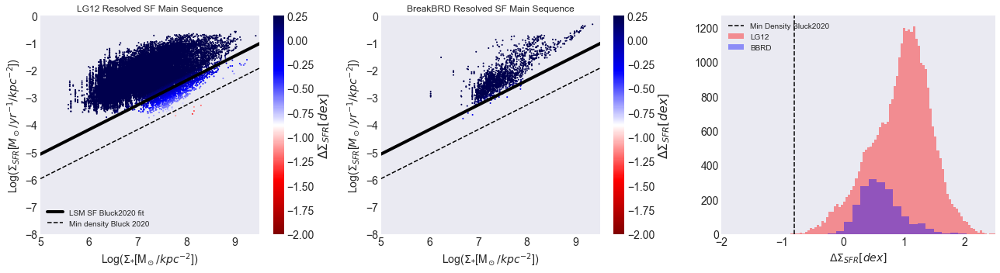

In [19]:
# Bluck et al 2020 LSM fit
logm_list = np.arange(5.0, 12.0, 0.1)
bluck_fit = 0.90 * logm_list - 9.57


fig, ((ax1,ax2, ax3)) = plt.subplots(1, 3, figsize=(18, 5))

im1 = ax1.scatter(lg12_sf_snr_cut_o3val_ifu_df['MSUN/SPX2'], lg12_sf_snr_cut_o3val_ifu_df['SFR DENSITY'], s=1, c=lg12_sf_snr_cut_o3val_ifu_df['B20 DELTASFR'], cmap='seismic_r', vmin=-2.0, vmax=0.25)
#im2 = ax1.scatter(lg12_sf_snr_cut_o3uplim_ifu_df['MSUN/SPX2'], lg12_sf_snr_cut_o3uplim_ifu_df['SFR DENSITY'], s=1, color='pink', label='OIII/Halpha upper limit')
ax1.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax1.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
cb = fig.colorbar(im1, ax=ax1, orientation='vertical')
cb.set_label(label=r'$\Delta \Sigma_{SFR}[dex]$', size=16, weight='bold')
cb.ax.tick_params(labelsize=14)
ax1.set_xlim(5,9.5)
ax1.set_ylim(-8,0)
ax1.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
ax1.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)
ax1.set_title('LG12 Resolved SF Main Sequence')
ax1.tick_params(labelsize=14)
ax1.legend()


im3 = ax2.scatter(bbrd_sf_snr_cut_o3val_ifu_df['MSUN/SPX2'], bbrd_sf_snr_cut_o3val_ifu_df['SFR DENSITY'], s=1, c=bbrd_sf_snr_cut_o3val_ifu_df['B20 DELTASFR'], cmap='seismic_r', vmin=-2.0, vmax=0.25)
#im4 = ax2.scatter(bbrd_sf_snr_cut_o3uplim_ifu_df['MSUN/SPX2'], bbrd_sf_snr_cut_o3uplim_ifu_df['SFR DENSITY'], s=1, color='pink', label='OIII/Halpha upper limit')
ax2.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax2.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
cb = fig.colorbar(im3, ax=ax2, orientation='vertical')
cb.set_label(label=r'$\Delta \Sigma_{SFR}[dex]$', size=16, weight='bold')
cb.ax.tick_params(labelsize=14)
ax2.set_xlim(5,9.5)
ax2.set_ylim(-8,0)
#ax2.set_title('BBRD Star-forming Main Sequence ({} SF and Composite spaxels)'.format(bbrd_sf_snr_cut_o3val_ifu_df['BPT CLASS'].count()), fontsize=15)
ax2.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
ax2.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)
ax2.set_title('BreakBRD Resolved SF Main Sequence')
ax2.tick_params(labelsize=14)

sns.distplot(lg12_sf_snr_cut_o3val_ifu_df['B20 DELTASFR'], bins=100, color='red', ax=ax3, kde=False, label='LG12')
#sns.distplot(lg12_sf_snr_cut_o3uplim_ifu_df['B20 DELTASFR'], bins=10, color='black', ax=ax3, kde=False, label='LG12 OIII/Halpha upper lim')
sns.distplot(bbrd_sf_snr_cut_o3val_ifu_df['B20 DELTASFR'], bins=20, color='blue', ax=ax3, kde=False, label='BBRD')
#sns.distplot(bbrd_sf_snr_cut_o3uplim_ifu_df['B20 DELTASFR'], bins=10, color='green', ax=ax3, kde=False, label='BBRD OIII/Halpha upper lim')
ax3.axvline(-0.8, color='black', linestyle='--', label='Min Density Bluck2020')
ax3.set_xlabel(r'$\Delta \Sigma_{SFR}[dex]$', fontsize=14)
ax3.set_xlim(-2,2.5)
ax3.tick_params(labelsize=14)
ax3.legend()

fig.tight_layout()
plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/resolved_sfms_dsfr.jpeg')
plt.show()

In [ ]:
# 2D Delta SFR radial profile and SFMS Map

In [ ]:
fig, (ax1, ax2, ax3, ax4, ax5)= plt.subplots(1,5, figsize=(35,6))
im1 = ax1.imshow(delta_sfr, vmin=-2.0, vmax=0.25, origin='lower', cmap='seismic_r')
fig.colorbar(im1, ax=ax1, label='$\Delta$SFR [dex]', aspect=5.3, orientation='vertical')
ax1.set_title('$\Delta$SFR = Log($\Sigma_{SFR}$) - Log($\Sigma_{SFR(MS)}$)', fontsize=20)
ax2.scatter(radius_map, delta_sfr, c=delta_sfr, cmap='seismic_r', vmin=-2.0,   vmax=0.25)
ax2.set_xlabel('$R/R_{eff}$', fontsize=15)
ax2.set_ylabel('$\Delta$SFR [dex]', fontsize=15)
ax2.axhline(0.5, color='magenta', label='Starburst dex>0.5')
ax2.axhline(-1.1, color='red', label='Quenched dex<-0.5')
ax2.axhline(-0.5, color='blue', label='Main Sequence 0.5, -0.5dex')
ax2.grid()
ax2.legend()
ax3.scatter(mass_density, sfrd_map, c=delta_sfr, cmap='seismic_r', vmin=-2.0,   vmax=0.25)
logm_list = np.arange(5.0, 11.0, 0.1)
sfms_fit = 0.90 * logm_list - 9.57
ax3.plot(logm_list, sfms_fit, color='aqua', label='LSM fit')
ax3.plot(logm_list, sfms_fit-0.9, color='black', label='Min density Bluck 2020',   linestyle='--')
ax3.set_xlabel('$\Sigma_{M_\star} [M_\odot/spaxel^2]$', fontsize=20)
ax3.set_ylabel('$\Sigma_{SFR} [M_\odot yr^-1 kpc^-2]$', fontsize=20)
ax3.set_xlim(5,10)
ax3.set_title('Star-forming Main Sequence', fontsize=15)
ax3.grid()
ax3.legend()
ax4.hist(delta_sfr[~np.isinf(delta_sfr)], bins=50, color='blue', alpha=0.5)
ax4.axvline(-0.8, color='black',linestyle='--', label='Bluck 2020, min of dist')
ax4.axvline(-1.1, color='red',linestyle='-', label='Quenched')
ax4.axvline(0.5, color='magenta',linestyle='-', label='Starburst')
ax4.axvline(-0.5, color='blue',linestyle='-', label='Main Sequence')
ax4.set_xlabel('$\Delta$SFR', fontsize=20)
ax4.set_ylabel('Frequency', fontsize=20)
ax4.set_xlim(-2.5,1.0)
ax4.legend()
# Image
im1 = Image(plateifu)
imfn = im1.filename
img = mpimg.imread(imfn)
imgplot = ax5.imshow(img, aspect=1.0)
#ax1.set_xlim(150,400)
#ax1.set_ylim(400, 150)
ax5.axis('off')
ax5.set_title(plateifu, fontsize=14)
ax5.set_aspect(1)
plt.rc('xtick', labelsize=15)
plt.rc('ytick', labelsize=15)
fig.tight_layout()
#plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/{}_deltaSFR_plots/{}_deltaSFR.jpeg'.format(sample, plaeifu))
plt.close()

# Global Star forming Main Seqence

In [20]:
lg12_global_df.columns

Index(['Unnamed: 0', 'RASDSSinfo', 'DecSDSSinfo', 'zSDSSinfo',
       'HalphaSDSSline [1e-17*erg/cm^2/s]',
       'OIII5007SDSSline [1e-17*erg/cm^2/s]',
       'OIII4959SDSSline [1e-17*erg/cm^2/s]',
       'HbetaSDSSline [1e-17*erg/cm^2/s]', 'HdeltaSDSSline [1e-17*erg/cm^2/s]',
       'N6583SDSS [1e-17*erg/cm^2/s]', 'S6717SDSSline [1e-17*erg/cm^2/s]',
       'S6731SDSSline [1e-17*erg/cm^2/s]',
       'OII3726SDSSline [1e-17*erg/cm^2/s]',
       'OII3729SDSSline [1e-17*erg/cm^2/s]',
       'OI6300SDSSline [1e-17*erg/cm^2/s]', 'HalphaSDSSline_ERR',
       'OIII5007SDSSline_ERR', 'OIII4959SDSSline_ERR', 'HbetaSDSSline_ERR',
       'HdeltaSDSSline_ERR', 'N6583SDSS_ERR', 'S6717SDSSline_ERR',
       'S6731SDSSline_ERR', 'OII3726SDSSline_ERR', 'OII3729SDSSline_ERR',
       'OI6300SDSSline_ERR', 'Dn4000SDSSindx', 'petroRad', 'petroRadE',
       'petroR50', 'petroR50E', 'petroR90', 'petroR90E',
       'Metallicity_med(T04)', 'Metallicity_avg(T04)', 'Mstaravg_SDSStotlgm',
       'Mstarmed_SDSSto

In [21]:
# Global Delta SFR - Bluck et al 2020
#lg12_logm_list = np.linspace(9.0, 12.0, len(lg12_global_df['RASDSSinfo']))
#lg12_logm_list.shape

#bbrd_logm_list = np.linspace(9.0, 12.0, len(bbrd_global_df['RASDSSinfo']))
#bbrd_logm_list.shape

lg12_B20_lgsfr = 0.90 * lg12_global_df['Mstarmed_SDSStotlgm'] - 9.57 # Bluck least square minimization fit
#lg12_B20_lgsfr.shape
lg12_global_delta_sfr = lg12_global_df['totalSFR_Med'] - lg12_B20_lgsfr

bbrd_B20_lgsfr = 0.90 * bbrd_global_df['Mstarmed_SDSStotlgm'] - 9.57 # Bluck least square minimization fit
#bbrd_B20_lgsfr.shape
bbrd_global_delta_sfr = bbrd_global_df['totalSFR_Med'] - bbrd_B20_lgsfr

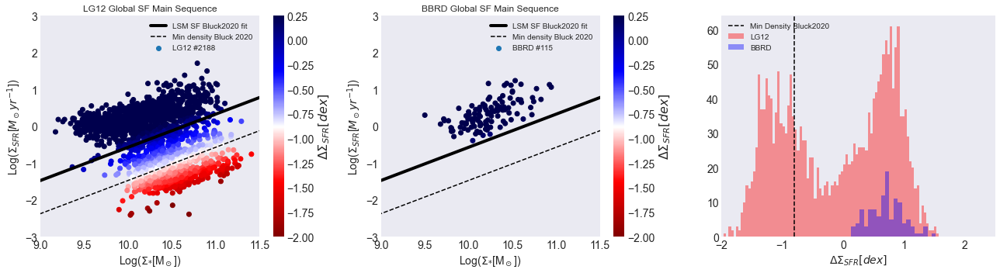

In [22]:
fig, ((ax1,ax2, ax3)) = plt.subplots(1, 3, figsize=(18, 5))

im1 = ax1.scatter(lg12_global_df['Mstarmed_SDSStotlgm'], lg12_global_df['totalSFR_Med'], c=lg12_global_delta_sfr, cmap='seismic_r', vmin=-2.0, vmax=0.25, label='LG12 #{}'.format(len(lg12_global_df['totalSFR_Med'])))
cb = fig.colorbar(im1, ax=ax1, orientation='vertical')
cb.set_label(label=r'$\Delta \Sigma_{SFR}[dex]$', size=16, weight='bold')
cb.ax.tick_params(labelsize=14)
ax1.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax1.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
ax1.set_xlim(9,11.5)
ax1.set_ylim(-3,3)
ax1.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot$])', fontsize=14)
ax1.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot yr^{-1}$]) ', fontsize=14)
ax1.set_title('LG12 Global SF Main Sequence')
ax1.tick_params(labelsize=14)
ax1.legend()


im2 = ax2.scatter(bbrd_global_df['Mstarmed_SDSStotlgm'], bbrd_global_df['totalSFR_Med'], c=bbrd_global_delta_sfr, cmap='seismic_r', vmin=-2.0, vmax=0.25, label='BBRD #{}'.format(len(bbrd_global_df['totalSFR_Med'])))
cb = fig.colorbar(im2, ax=ax2, orientation='vertical')
cb.set_label(label=r'$\Delta \Sigma_{SFR}[dex]$', size=16, weight='bold')
cb.ax.tick_params(labelsize=14)
ax2.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax2.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
ax2.set_xlim(9,11.5)
ax2.set_ylim(-3,3)
ax2.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot$])', fontsize=14)
ax2.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot yr^{-1}$]) ', fontsize=14)
ax2.set_title('BBRD Global SF Main Sequence')
ax2.tick_params(labelsize=14)
ax2.legend()

sns.distplot(lg12_global_delta_sfr, bins=100, color='red', ax=ax3, kde=False, label='LG12')
#sns.distplot(lg12_sf_snr_cut_o3uplim_ifu_df['B20 DELTASFR'], bins=10, color='black', ax=ax3, kde=False, label='LG12 OIII/Halpha upper lim')
sns.distplot(bbrd_global_delta_sfr, bins=20, color='blue', ax=ax3, kde=False, label='BBRD')
#sns.distplot(bbrd_sf_snr_cut_o3uplim_ifu_df['B20 DELTASFR'], bins=10, color='green', ax=ax3, kde=False, label='BBRD OIII/Halpha upper lim')
ax3.axvline(-0.8, color='black', linestyle='--', label='Min Density Bluck2020')
ax3.set_xlabel(r'$\Delta \Sigma_{SFR}[dex]$', fontsize=14)
ax3.set_xlim(-2,2.5)
ax3.tick_params(labelsize=14)
ax3.legend()

fig.tight_layout()
plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/global_sfms_dsfr.jpeg')


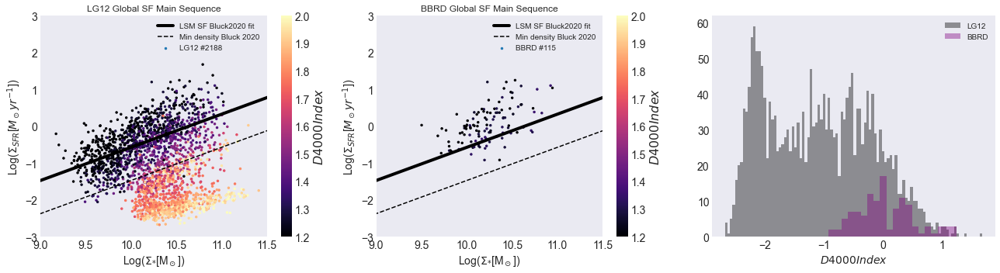

In [35]:
fig, ((ax1,ax2, ax3)) = plt.subplots(1, 3, figsize=(18, 5))

im1 = ax1.scatter(lg12_global_df['Mstarmed_SDSStotlgm'], lg12_global_df['fibSFR_med_all'], s=6, c=lg12_global_df['Dn4000SDSSindx'], cmap='magma', vmin=1.2, vmax=2.0, label='LG12 #{}'.format(len(lg12_global_df['fibSFR_med_all'])))
cb = fig.colorbar(im1, ax=ax1, orientation='vertical')
cb.set_label(label=r'$D4000 Index$', size=16, weight='bold')
cb.ax.tick_params(labelsize=14)
ax1.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax1.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
ax1.set_xlim(9,11.5)
ax1.set_ylim(-3,3)
ax1.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot$])', fontsize=14)
ax1.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot yr^{-1}$]) ', fontsize=14)
ax1.set_title('LG12 Global SF Main Sequence')
ax1.tick_params(labelsize=14)
ax1.legend()


im2 = ax2.scatter(bbrd_global_df['Mstarmed_SDSStotlgm'], bbrd_global_df['fibSFR_med_all'], s=6, c=bbrd_global_df['Dn4000SDSSindx'], cmap='magma', vmin=1.2, vmax=2.0, label='BBRD #{}'.format(len(bbrd_global_df['fibSFR_med_all'])))
cb = fig.colorbar(im2, ax=ax2, orientation='vertical')
cb.set_label(label=r'$D4000 Index$', size=16, weight='bold')
cb.ax.tick_params(labelsize=14)
ax2.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax2.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
ax2.set_xlim(9,11.5)
ax2.set_ylim(-3,3)
ax2.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot$])', fontsize=14)
ax2.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot yr^{-1}$]) ', fontsize=14)
ax2.set_title('BBRD Global SF Main Sequence')
ax2.tick_params(labelsize=14)
ax2.legend()

sns.distplot(lg12_global_df['fibSFR_med_all'], bins=100, color='black', ax=ax3, kde=False, label='LG12')
#sns.distplot(lg12_sf_snr_cut_o3uplim_ifu_df['B20 DELTASFR'], bins=10, color='black', ax=ax3, kde=False, label='LG12 OIII/Halpha upper lim')
sns.distplot(bbrd_global_df['fibSFR_med_all'], bins=20, color='purple', ax=ax3, kde=False, label='BBRD')
#sns.distplot(bbrd_sf_snr_cut_o3uplim_ifu_df['B20 DELTASFR'], bins=10, color='green', ax=ax3, kde=False, label='BBRD OIII/Halpha upper lim')
#ax3.axvline(-0.8, color='black', linestyle='--', label='Min Density Bluck2020')
ax3.set_xlabel(r'$D4000 Index$', fontsize=14)
#ax3.set_xlim(-2,2.5)
ax3.tick_params(labelsize=14)
ax3.legend()

fig.tight_layout()
plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/global_fibsfms.jpeg')


# O3Halpha vs N2O2 diagnostic Quai et al 2018 - uses tracers for ionization and metallicity to classify spaxels in early stages of quenching

In [25]:
# N2O2 ratio 
lg12_n2o2_o3val_ratio = np.log10(lg12_sf_snr_cut_o3val_ifu_df['NII6585 KCORR'] / (lg12_sf_snr_cut_o3val_ifu_df['OII3727 KCORR'] + lg12_sf_snr_cut_o3val_ifu_df['OII3729 KCORR']))
bbrd_n2o2_o3val_ratio = np.log10(bbrd_sf_snr_cut_o3val_ifu_df['NII6585 KCORR'] / (bbrd_sf_snr_cut_o3val_ifu_df['OII3727 KCORR'] + bbrd_sf_snr_cut_o3val_ifu_df['OII3729 KCORR']))

# OIII/Halpha Upper limit N2O2 ratio [OIII] < 2
lg12_n2o2_o3uplim_ratio = np.log10(lg12_sf_snr_cut_o3uplim_ifu_df['NII6585 KCORR'] / (lg12_sf_snr_cut_o3uplim_ifu_df['OII3727 KCORR'] + lg12_sf_snr_cut_o3uplim_ifu_df['OII3729 KCORR']))
bbrd_n2o2_o3uplim_ratio = np.log10(bbrd_sf_snr_cut_o3uplim_ifu_df['NII6585 KCORR'] / (bbrd_sf_snr_cut_o3uplim_ifu_df['OII3727 KCORR'] + bbrd_sf_snr_cut_o3uplim_ifu_df['OII3729 KCORR']))

# O3Halpha ratio
lg12_o3ha_o3val_ratio = np.log10(lg12_sf_snr_cut_o3val_ifu_df['OIII5008 KCORR'] / lg12_sf_snr_cut_o3val_ifu_df['HALPHA KCORR'])
bbrd_o3ha_o3val_ratio = np.log10(bbrd_sf_snr_cut_o3val_ifu_df['OIII5008 KCORR'] / bbrd_sf_snr_cut_o3val_ifu_df['HALPHA KCORR'])
# OIII/Halpha Upper limit O3Halpha ratio 
lg12_o3ha_o3uplim_ratio = np.log10(lg12_sf_snr_cut_o3uplim_ifu_df['OIII5008 KCORR'] / lg12_sf_snr_cut_o3uplim_ifu_df['HALPHA KCORR'])
bbrd_o3ha_o3uplim_ratio = np.log10(bbrd_sf_snr_cut_o3uplim_ifu_df['OIII5008 KCORR'] / bbrd_sf_snr_cut_o3uplim_ifu_df['HALPHA KCORR'])

# Quai et al 2018 O3Halpha vs N2O2 polynomial
Q18_n2o2_range = np.linspace(-1.5,0.5,50)
Q18_o3ha_range = np.linspace(-1.75,0.25,50)

q18_polyfit = -1.09 - (0.11 * Q18_n2o2_range) + (1.39 * Q18_n2o2_range**2) + (0.67 * Q18_n2o2_range**3)
q18_polyfit_1sigma = -1.22 - (0.09 * Q18_n2o2_range) + (1.48 * Q18_n2o2_range**2) + (0.76 * Q18_n2o2_range**3) # 16th percentile of fit but rerpersents 1 sigma
q18_polyfit_3sigma = -1.47 - (0.21 * Q18_n2o2_range) + (1.04 * Q18_n2o2_range**2) + (0.53 * Q18_n2o2_range**3) # .15th percentile of fit but rerpersents 3 sigma

[WARNING]: /Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/pandas/core/series.py:726: RuntimeWarning:

divide by zero encountered in log10




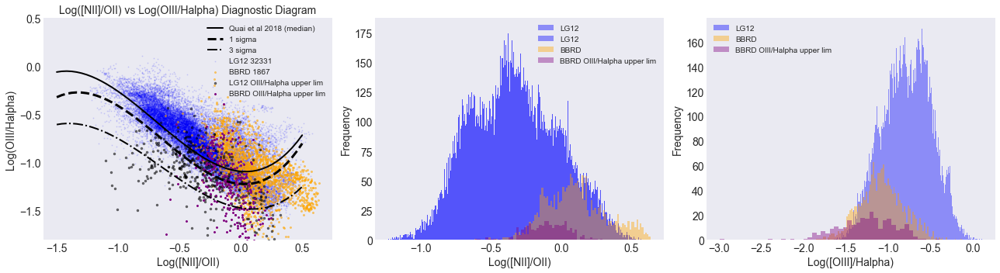

In [26]:
# O3Halpha vs N2O2 diagnostic Quai et al 2018 - uses tracers for ionization and metallicity to classify spaxels in early stages of quenching
fig, (ax1,ax2,ax3) = plt.subplots(1,3, figsize=(18,5))

# Log([NII]/OII) vs Log(OIII/Halpha) Diagnostic Diagram
im1 = ax1.scatter(lg12_n2o2_o3val_ratio, lg12_o3ha_o3val_ratio, color='blue', label='LG12 {}'.format(len(lg12_n2o2_o3val_ratio)), alpha=0.1, s=1)
im2 = ax1.scatter(bbrd_n2o2_o3val_ratio, bbrd_o3ha_o3val_ratio, color='orange', label='BBRD {}'.format(len(bbrd_n2o2_o3val_ratio)), alpha=0.5, s=4)

# upper limit values
im3 = ax1.scatter(lg12_n2o2_o3uplim_ratio, lg12_o3ha_o3uplim_ratio, color='black', label='LG12 OIII/Halpha upper lim', alpha=0.5, s=6, marker='o')
im4 = ax1.scatter(bbrd_n2o2_o3uplim_ratio, bbrd_o3ha_o3uplim_ratio, color='purple', label='BBRD OIII/Halpha upper lim', alpha=1, s=4, marker='x')

# Diagnostic fit
ax1.plot(Q18_n2o2_range, q18_polyfit, color='black', label='Quai et al 2018 (median)', linestyle='-', linewidth=2)
ax1.plot(Q18_n2o2_range, q18_polyfit_1sigma, color='black', label='1 sigma', linestyle='--', linewidth=3)
ax1.plot(Q18_n2o2_range, q18_polyfit_3sigma, color='black', label='3 sigma', linestyle='-.', linewidth=2)
ax1.set_xlabel('Log([NII]/OII)', fontsize=14)
ax1.set_ylabel('Log(OIII/Halpha)', fontsize=14)
ax1.set_title('Log([NII]/OII) vs Log(OIII/Halpha) Diagnostic Diagram', fontsize=14)
#ax1.set_xlim(-1.5,0.8)
ax1.set_ylim(-1.8, 0.5)
ax1.tick_params(labelsize=14)
ax1.legend()

## N2O2 distrubution
sns.distplot(lg12_n2o2_o3val_ratio, bins=500, kde=False,color='blue', ax=ax2, label='LG12')
#sns.distplot(lg12_n2o2_o3uplim_ratio, bins=500, kde=False,color='blue', ax=ax2, label='LG12')
sns.distplot(bbrd_n2o2_o3val_ratio, bins=100, kde=False,color='orange', ax=ax2, label='BBRD')
sns.distplot(bbrd_n2o2_o3uplim_ratio, bins=50,kde=False, color='purple', ax=ax2, label='BBRD OIII/Halpha upper lim')
ax2.set_ylabel('Frequency', fontsize=14)
ax2.set_xlabel('Log([NII]/OII)', fontsize=14)
ax2.tick_params(labelsize=14)
ax2.legend()

## O3N2 distrubution
sns.distplot(lg12_o3ha_o3val_ratio, bins=500, kde=False,color='blue', ax=ax3, label='LG12')
sns.distplot(bbrd_o3ha_o3val_ratio, bins=100, kde=False,color='orange', ax=ax3, label='BBRD')
sns.distplot(bbrd_o3ha_o3uplim_ratio, bins=50,kde=False, color='purple', ax=ax3, label='BBRD OIII/Halpha upper lim')
ax3.set_ylabel('Frequency', fontsize=14)
ax3.set_xlabel('Log([OIII]/Halpha)', fontsize=14)
ax3.tick_params(labelsize=14)
ax3.legend()


fig.tight_layout()
plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/resolved_Quai2018_snrcut_diagnostic.jpeg')

## 2D Maps Preprocessing

# Global measurments on Q18 diagnostic

In [28]:
lg12_global_df.columns

Index(['Unnamed: 0', 'RASDSSinfo', 'DecSDSSinfo', 'zSDSSinfo',
       'HalphaSDSSline [1e-17*erg/cm^2/s]',
       'OIII5007SDSSline [1e-17*erg/cm^2/s]',
       'OIII4959SDSSline [1e-17*erg/cm^2/s]',
       'HbetaSDSSline [1e-17*erg/cm^2/s]', 'HdeltaSDSSline [1e-17*erg/cm^2/s]',
       'N6583SDSS [1e-17*erg/cm^2/s]', 'S6717SDSSline [1e-17*erg/cm^2/s]',
       'S6731SDSSline [1e-17*erg/cm^2/s]',
       'OII3726SDSSline [1e-17*erg/cm^2/s]',
       'OII3729SDSSline [1e-17*erg/cm^2/s]',
       'OI6300SDSSline [1e-17*erg/cm^2/s]', 'HalphaSDSSline_ERR',
       'OIII5007SDSSline_ERR', 'OIII4959SDSSline_ERR', 'HbetaSDSSline_ERR',
       'HdeltaSDSSline_ERR', 'N6583SDSS_ERR', 'S6717SDSSline_ERR',
       'S6731SDSSline_ERR', 'OII3726SDSSline_ERR', 'OII3729SDSSline_ERR',
       'OI6300SDSSline_ERR', 'Dn4000SDSSindx', 'petroRad', 'petroRadE',
       'petroR50', 'petroR50E', 'petroR90', 'petroR90E',
       'Metallicity_med(T04)', 'Metallicity_avg(T04)', 'Mstaravg_SDSStotlgm',
       'Mstarmed_SDSSto

In [29]:
# LG12
lg12_global_o3ha_ratio = lg12_global_df['OIII5007_kcorr'] / lg12_global_df['Halpha_kcorr']
lg12_global_n2o2_ratio = lg12_global_df['NII6583_kcorr'] / (lg12_global_df['OII3726_kcorr'] + lg12_global_df['OII3729_kcorr'])

lg12_global_o3ha_ratio_nokcorr = lg12_global_df['OIII5007SDSSline [1e-17*erg/cm^2/s]'] / lg12_global_df['HalphaSDSSline [1e-17*erg/cm^2/s]']
lg12_global_n2o2_ratio_nokcorr = lg12_global_df['N6583SDSS [1e-17*erg/cm^2/s]'] / (lg12_global_df['OII3726SDSSline [1e-17*erg/cm^2/s]'] + lg12_global_df['OII3729SDSSline [1e-17*erg/cm^2/s]'])


#BBRD global sample
bbrd_global_o3ha_ratio = bbrd_global_df['OIII5007_kcorr'] / bbrd_global_df['Halpha_kcorr']
bbrd_global_n2o2_ratio = bbrd_global_df['NII6583_kcorr'] / (bbrd_global_df['OII3726_kcorr'] + bbrd_global_df['OII3729_kcorr'])


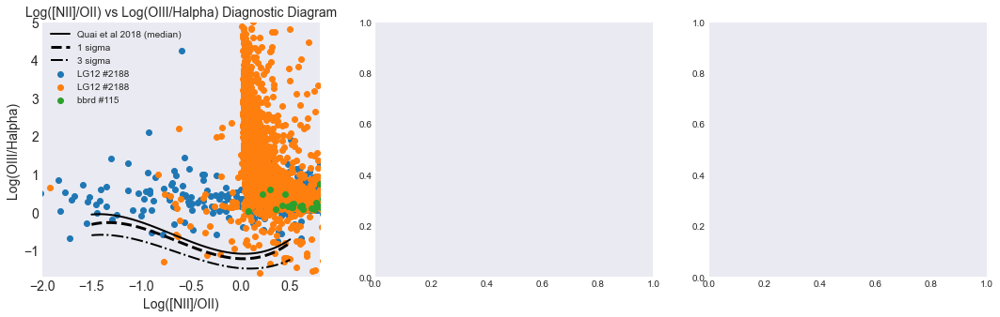

In [30]:
# Q18 diagnostic diagram
fig, (ax1,ax2,ax3) = plt.subplots(1,3, figsize=(18,5))

ax1.scatter(lg12_global_n2o2_ratio, lg12_global_o3ha_ratio, label='LG12 #{}'.format(len(lg12_global_o3ha_ratio)))
ax1.scatter(lg12_global_o3ha_ratio_nokcorr, lg12_global_n2o2_ratio_nokcorr, label='LG12 #{}'.format(len(lg12_global_o3ha_ratio)))
ax1.scatter(bbrd_global_n2o2_ratio, bbrd_global_o3ha_ratio, label='bbrd #{}'.format(len(bbrd_global_o3ha_ratio)))
ax1.plot(Q18_n2o2_range, q18_polyfit, color='black', label='Quai et al 2018 (median)', linestyle='-', linewidth=2)
ax1.plot(Q18_n2o2_range, q18_polyfit_1sigma, color='black', label='1 sigma', linestyle='--', linewidth=3)
ax1.plot(Q18_n2o2_range, q18_polyfit_3sigma, color='black', label='3 sigma', linestyle='-.', linewidth=2)
ax1.set_xlabel('Log([NII]/OII)', fontsize=14)
ax1.set_ylabel('Log(OIII/Halpha)', fontsize=14)
ax1.set_title('Log([NII]/OII) vs Log(OIII/Halpha) Diagnostic Diagram', fontsize=14)
ax1.set_xlim(-2,0.8)
ax1.set_ylim(-1.7, 5)
ax1.tick_params(labelsize=14)
ax1.legend()

In [35]:
lg12_sf_snr_cut_o3val_ifu_df.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'HALPHA', 'HALPHA KCORR', 'HBETA KCORR',
       'NII6585 KCORR', 'OII3727 KCORR', 'OII3729 KCORR', 'OIII5008 KCORR',
       'SII6718 KCORR', 'SII6732 KCORR', 'HALPHA SNR', 'HBETA SNR',
       'NII6585 SNR', 'OII3727 SNR', 'OII3729 SNR', 'OIII5008 SNR',
       'SII6718 SNR', 'SII6732 SNR', 'HALPHA ERROR', 'HBETA ERROR',
       'NII6585 ERROR', 'OII3727 ERROR', 'OII3729 ERROR', 'OIII5008 ERROR',
       'SII6718 ERROR', 'SII6732 ERROR', 'R-BAND SNR', 'HA/HB', 'HA LUM',
       'SFR', 'SFR DENSITY', 'ELLIP R', 'R/REFF', 'LOG(O/H)+12_[N2O2]',
       'LOG(O/H)+12_[O3N2]', 'LOG(O/H)+12_[N2]', 'GYR_LW', 'GYR_MW', 'GYR_ERR',
       'SP_ZSUBL', 'SP_ZSUBM', 'SP_ZERR', 'VEL_KM/S', 'VEL_ERR]', 'VDISP_KM/S',
       'VDISP_ERR', 'M/L', 'MSUN/SPX2', 'MSUN/ARCS2', 'MSUN/KPC2', 'D4000',
       'D4000_ERR', 'HDELTA', 'HDELTA_ERR', 'O3HB_RATIO', 'N2HA_RATIO',
       'BPT CLASS', 'B20 DELTASFR'],
      dtype='object')

# Resolved Mass-Metallicity Relation

In [27]:
# Preprocessing function
def apply_2Difu_snr_cut(hdu, ifu_2dmap):
    """
    About:
        This function will make signal-to-noise cuts to a specified data extension in 
        the FITS files produced by Myles McKay
    
    Parameters:
        hdu: fits files 
        
        ifu_2dmap: (ndarray)
            2 dimensional array that reperesnet the MaNGA IFU map


    """
    ifu_2d_ppd_map = ifu_2dmap
    ifu_2d_ppd_map[hdu['HALPHA SNR'].data < 5] = np.nan # Halpha mask with all the Halpha SNR spaxels < 3 set to np.nan
    ifu_2d_ppd_map[hdu['HBETA SNR'].data < 3] = np.nan 
    ifu_2d_ppd_map[hdu['NII6585 SNR'].data < 2] = np.nan 
    ifu_2d_ppd_map[hdu['OII3727 SNR'].data < 2] = np.nan 
    ifu_2d_ppd_map[hdu['OII3729 SNR'].data < 2] = np.nan 

    return ifu_2d_ppd_map

# Test the Mass-Metalliicty with 1D dataframnes created from 2D maps

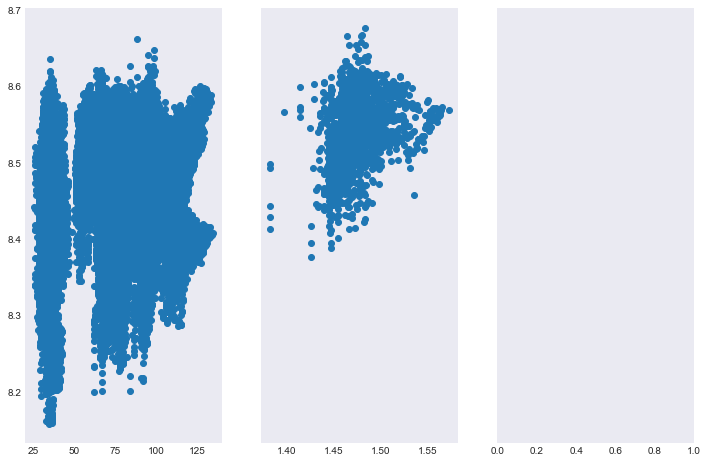

In [46]:
fig, (ax1, ax2, ax3) = plt.subplots(nrows=1,ncols=3, figsize=(12,8), sharey=True)

ax1.scatter((lg12_sf_snr_cut_o3val_ifu_df['MSUN/KPC2']), lg12_sf_snr_cut_o3val_ifu_df['LOG(O/H)+12_[O3N2]'])

ax2.scatter(np.log10(bbrd_sf_snr_cut_o3val_ifu_df['MSUN/ARCS2']), bbrd_sf_snr_cut_o3val_ifu_df['LOG(O/H)+12_[O3N2]'])

# ----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [ ]:
# # Bluck et al 2020 LSM fit
# logm_list = np.arange(5.0, 11.0, 0.1)
# bluck_fit = 0.90 * logm_list - 9.57


# fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2, 2, figsize=(14, 8))
# im1 = ax1.scatter(lg12_sf_hasnr_cut_ifu_df['MSUN/SPX2'], lg12_sf_hasnr_cut_ifu_df['SFR DENSITY'], s=1, c=lg12_sf_hasnr_cut_ifu_df['BPT CLASS'], cmap='viridis')
# ax1.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
# ax1.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
# fig.colorbar(im1, ax=ax1, label='BPT Class', orientation='vertical', spacing='uniform', boundaries=[0.5,1.5,2.5])
# ax1.set_xlim(5,9.5)
# ax1.set_ylim(-8,0)
# ax1.set_title('LG12 Star-forming Main Sequence ({} SF and Composite spaxels)'.format(lg12_sf_hasnr_cut_ifu_df['BPT CLASS'].count()), fontsize=15)
# ax1.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
# ax1.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)


# im2 = ax2.scatter(bbrd_sf_hasnr_cut_ifu_df['MSUN/SPX2'], bbrd_sf_hasnr_cut_ifu_df['SFR DENSITY'], s=1, c=bbrd_sf_hasnr_cut_ifu_df['BPT CLASS'], cmap='viridis')
# ax2.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
# ax2.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
# fig.colorbar(im2, ax=ax2, label='BPT Class', orientation='vertical', spacing='uniform', boundaries=[0.5,1.5,2.5])
# ax2.set_xlim(5,9.5)
# ax2.set_ylim(-8,0)
# ax2.set_title('BBRD Star-forming Main Sequence ({} SF and Composite spaxels)'.format(bbrd_sf_hasnr_cut_ifu_df['BPT CLASS'].count()), fontsize=15)
# ax2.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
# ax2.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)
# ax2.legend()


# im3 = ax3.scatter(lg12_sf_hasnr_cut_ifu_df['MSUN/SPX2'], lg12_sf_hasnr_cut_ifu_df['SFR DENSITY'], s=1, c=lg12_sf_hasnr_cut_ifu_df['B20 DELTASFR'], cmap='seismic_r', vmin=-2.0, vmax=0.25)
# ax3.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
# ax3.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
# fig.colorbar(im3, ax=ax3, label=r'$\Delta \Sigma_{SFR}[dex]$', orientation='vertical')
# ax3.set_xlim(5,9.5)
# ax3.set_ylim(-8,0)
# #ax3.set_title('LG12 Star-forming Main Sequence ({} SF and Composite spaxels)'.format(lg12_sf_ifu_df['BPT CLASS'].count()), fontsize=15)
# ax3.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
# ax3.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)


# im4 = ax4.scatter(bbrd_sf_hasnr_cut_ifu_df['MSUN/SPX2'], bbrd_sf_hasnr_cut_ifu_df['SFR DENSITY'], s=1, c=bbrd_sf_hasnr_cut_ifu_df['B20 DELTASFR'], cmap='seismic_r', vmin=-2.0, vmax=0.25)
# ax4.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
# ax4.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
# fig.colorbar(im4, ax=ax4, label=r'$\Delta \Sigma_{SFR}[dex]$', orientation='vertical')
# ax4.set_xlim(5,9.5)
# ax4.set_ylim(-8,0)
# #ax4.set_title('BBRD Star-forming Main Sequence ({} SF and Composite spaxels)'.format(bbrd_sf_hasnr_cut_ifu_df['BPT CLASS'].count()), fontsize=15)
# ax4.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
# ax4.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)


# fig.tight_layout()
# plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/sfms_dsfr_hasnrclip_bptclass.jpeg')
# plt.show()

In [ ]:
# #sns.kdeplot(bbrd_global_df['Mstarmed_SDSStotlgm'], bbrd_global_df['fibSFR_med_all'], ax=ax3)
# fig, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2,2,figsize=(12,8))
# logm_list = np.arange(5.0, 12.0, 0.1)
# rp2015_fit = 0.76 * logm_list - 7.64
# ax1.plot(logm_list, rp2015_fit, label='Renzini & Peng 2015', linewidth=4, color='black')
# ax1.plot(logm_list, rp2015_fit-0.7, label='Min density contour', linewidth=2, linestyle='--', color='black')
# ax1.scatter(lg12_global_df['Mstarmed_SDSStotlgm'], lg12_global_df['fibSFR_med_all'], color='coral', label='LG12-SDSS')
# ax1.scatter(bbrd_global_df['Mstarmed_SDSStotlgm'], bbrd_global_df['fibSFR_med_all'], color='aqua', label='BBRD-SDSS')
# ax1.set_xlabel(r'Log($M_\star[M_\odot]$)', fontsize=14)
# ax1.set_ylabel(r'Log(SFR) M$_\odot/yr^{-1}$', fontsize=14)
# ax1.set_xlim(9,11.5)
# ax1.set_ylim(-3,1.5)
# ax1.legend()


# ax2.hist(lg12_global_df['fibSFR_med_all'], bins=50, alpha=0.5, color='coral')
# ax2.hist(bbrd_global_df['fibSFR_med_all'], bins=50, alpha=0.5, color='aqua')

# # Bluck et al 2020 LSM fit
# logm_list = np.arange(5.0, 11.0, 0.1)
# bluck_fit = 0.90 * logm_list - 9.57


# #Plot
# ax3.plot(logm_list, bluck_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
# ax3.plot(logm_list, bluck_fit-0.9, color='black', label='Min density Bluck 2020', linestyle='--')
# ax3.scatter(lg12_sf_ifu_df['MSUN/SPX2'], lg12_sf_ifu_df['SFR DENSITY'], color='coral', label='LG12-MaNGA')
# ax3.scatter(bbrd_sf_ifu_df['MSUN/SPX2'], bbrd_sf_ifu_df['SFR DENSITY'], color='aqua', label='BBRD-MaNGA')
# ax3.set_xlabel(r'Log($\Sigma_{*}$[M$_\odot/kpc^{-2}$])', fontsize=14)
# ax3.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) ', fontsize=14)
# ax3.set_xlim(6.0,10)
# ax3.set_ylim(-8,0)
# ax3.legend()



# ax4.hist(lg12_sf_ifu_df['SFR DENSITY'], bins=50, alpha=0.5, color='coral')
# ax4.hist(bbrd_sf_ifu_df['SFR DENSITY'], bins=50, alpha=0.5, color='aqua')
# ax4.set_xlim(-8,0)

# plt.show()

In [ ]:
import scipy.stats as st

# Add 2d kde for better visuals
xmin, xmax = 8.5, 12
ymin, ymax = -4, 2

# Peform the kernel density estimate
xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
positions = np.vstack([xx.ravel(), yy.ravel()])
values = np.vstack([lg12_global_df['Mstarmed_SDSStotlgm'], lg12_global_df['fibSFR_med_all']])
kernel = st.gaussian_kde(values)
f = np.reshape(kernel(positions).T, xx.shape)
plt.figure(figsize=(8,6))
cfset = plt.contourf(xx, yy, f, cmap='Blues', label='LG12')
cset = plt.contour(xx, yy, f, colors='k', label='LG12')
plt.clabel(cset, inline=1, fontsize=10)



# logm_list = np.arange(5.0, 12.0, 0.1)
# sfms_fit = 0.90 * logm_list - 9.57
# plt.plot(logm_list, sfms_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
# plt.plot(logm_list, sfms_fit-0.9, color='coral', label='Min density Bluck 2020',   linestyle='--')
logm_list = np.arange(5.0, 12.0, 0.1)
rp2015_fit = 0.76 * logm_list - 7.64
plt.plot(logm_list, rp2015_fit, label='Renzini & Peng 2015', linewidth=4, color='black')
plt.plot(logm_list, rp2015_fit-0.7, label='Min density contour', linewidth=2, linestyle='--', color='black')
plt.scatter(bbrd_global_df['Mstarmed_SDSStotlgm'], bbrd_global_df['fibSFR_med_all'], s=11, alpha=0.9, color='orange', label='BBRD SF galaxies', marker='+') # BreakBrd galxey
#plt.plot(bluck_mass, sfr_yfit, color='black', label='Renzini & Peng (2015)')
#plt.plot(bluck_mass, np.array(sfr_yfit)-0.7, color='green', label='Min density contour')
plt.xlabel('Log($M_\star$ [$M_\odot$])')
plt.ylabel('Log($SFR_MS$ [$M_\odot$$yr^-1$])')
plt.xlim(8.5,12)
plt.ylim(-4,1.5)
plt.title('Global Main Sequence')
plt.legend()
plt.show()

In [ ]:
sns.distplot(bbrd_ifu_df['B20 DELTASFR'], bins=10, kde=False, color='purple', label='BBRD')
sns.distplot(lg12_ifu_df['B20 DELTASFR'], bins=10, kde=False, color= 'green', label='LG12')
plt.legend()

In [ ]:
sns.distplot(bbrd_ifu_df['B20 DELTASFR'], bins=10, kde=False, color='purple', label='BBRD')
sns.distplot(lg12_ifu_df['B20 DELTASFR'], bins=10, kde=False, color= 'green', label='LG12')
plt.legend()

In [ ]:
sns.distplot(np.log10(bbrd_ifudf['SFR DENSITY']), bins=10, kde=False)
sns.distplot(np.log10(lg12_ifudf['SFR DENSITY']), bins=20, kde=False)

In [ ]:
sns.distplot(bbrd_ifudf['MSUN/SPX2'], bins=20, kde=False)
sns.distplot(lg12_ifudf['MSUN/SPX2'], bins=20, kde=False)

In [ ]:
sns.scatterplot(x=lg12_ifudf['R/REFF'], y=np.log10(lg12_ifudf['SFR DENSITY']), color='aqua')
sns.scatterplot(x=bbrd_ifudf['R/REFF'], y=np.log10(bbrd_ifudf['SFR DENSITY']), color='coral')
plt.ylim(-8,0)

In [ ]:
sns.scatterplot(x=lg12_ifudf['R/REFF'], y=lg12_ifudf['D4000'], color='aqua')
sns.scatterplot(x=bbrd_ifudf['R/REFF'], y=bbrd_ifudf['D4000'], color='coral')
plt.ylim(0.5, 3)
plt.xlim(-0.2,5)

In [ ]:
bbrd_sfms = sns.jointplot(x=bbrd_ifudf['MSUN/SPX2'], y=np.log10(bbrd_ifudf['SFR DENSITY']), kind="hex", color='coral')
# JointGrid has a convenience function
bbrd_sfms.set_axis_labels('x', 'y', fontsize=16)
# or set labels via the axes objects
bbrd_sfms.ax_joint.set_xlabel('Msun/arcsec2', fontweight='bold')


lg12_sfms = sns.jointplot(x=lg12_ifudf['MSUN/SPX2'], y=np.log10(lg12_ifudf['SFR DENSITY']), kind="hex", color='aqua')


In [ ]:
sns.jointplot(x=bbrd_supercsv['R/REFF'], y=np.log10(bbrd_supercsv['SFR DENSITY']), kind="hex", color='coral')

In [ ]:
sns.jointplot(x=bbrd_supercsv['R/REFF'], y=bbrd_supercsv['D4000'], kind="hex", color='coral')

In [ ]:
sns.distplot(bbrd_supercsv['SFR DENSITY'], bins=50)

In [ ]:
## Read data from fits file
#mass_Mspx2_map_8595_3703 = read_fits_ext(fits_filelist[1], ext=23)
#mass_Mspx2_map_8550_12703 = read_fits_ext(fits_filelist[3], ext=23)
#
#r_reff_map_8595_3703 = read_fits_ext(fits_filelist[1], ext=8)
#r_reff_map_8550_12703 = read_fits_ext(fits_filelist[3], ext=8)
##mass_Mspx2_map_8550_12703.shape
#
## Flatten 2D map into 1D column
##8550_12703
#mass_Mspx2_map_8550_12703_flat = mass_Mspx2_map_8550_12703.flatten(order='C')
#r_reff_map_8550_12703_flat = r_reff_map_8550_12703.flatten(order='C')
#
#mass_Mspx2_map_8595_3703_flat = mass_Mspx2_map_8595_3703.flatten(order='C')
#r_reff_map_8595_3703_flat = r_reff_map_8595_3703.flatten(order='C')
#
#
## Input flatten array to DataFrame as a columns
#ifu1_df = pd.DataFrame()
#ifu1_df['Mass lg(M/kpc2)'] = mass_Mspx2_map_8550_12703_flat
#ifu1_df['R/Reff'] = r_reff_map_8550_12703_flat
#ifu1_df
#
#ifu2_df = pd.DataFrame()
#ifu2_df['Mass lg(M/kpc2)'] = mass_Mspx2_map_8595_3703_flat
#ifu2_df['R/Reff'] = r_reff_map_8595_3703_flat
#ifu2_df



In [ ]:
# Append all the dataframes along the row axes
#bbrd_combo_df = ifu1_df.append(ifu2_df, ignore_index=False)
#bbrd_combo_df

In [ ]:
# Close files when done
hdu_8550_12703.close()
hdu_8312_12704.close()
hdu_10001_3702.close()
hdu_8254_1902.close()
hdu_8595_3703.close()

# Data Analysis Section

# Radial Profile of BBRD galaxies

In [ ]:
#hdelta_10001_3702 = hdu_10001_3702[28].data
#hdeltaerr_10001_3702 = hdu_10001_3702[29].data

#plt.errorbar(r_reff_map_10001_3702.flatten(), hdelta_10001_3702.flatten(), yerr=hdeltaerr_10001_3702.flatten(), ls='none')
#plt.scatter(r_reff_map_10001_3702, hdelta_10001_3702, color='coral', alpha=0.9, s=5)
#plt.ylim(-20, 20)
#plt.show()

# Mass - Metallicity relation

In [4]:
fig, (ax1, ax2, ax3) = plt.subplots(nrows=1,ncols=3, figsize=(12,8), sharex=True, sharey=True)

# Mass density Msun/arcsec2
ax1.scatter(x=mass_Mspx2_map_8550_12703, y=n2o2_map_8550_12703, alpha=0.5,  color='blue', s=6, label='8550_12703')
ax1.scatter(x=mass_Mspx2_map_8312_12704, y=n2o2_map_8312_12704, alpha=0.5,  color='red', s=6, label='8312_12704')
ax1.scatter(x=mass_Mspx2_map_10001_3702, y=n2o2_map_10001_3702, alpha=0.5,  color='green', s=6, label='10001_3702')
ax1.scatter(x=mass_Mspx2_map_8254_1902,  y=n2o2_map_8254_1902,  alpha=0.5, color='purple', s=6, label='8254_1902')
ax1.scatter(x=mass_Mspx2_map_8595_3703,  y=n2o2_map_8595_3703,  alpha=0.5, color='orange', s=6, label='8595_3703')
#ax1.set_ylabel('Log(O/H)+12 N2O2', fontsize=14)
ax1.set_title('Log(O/H)+12 N2O2', fontsize=14)
#ax1.set_xlabel(r'$Log(Mass M_{\odot}/kpc^{2})$', fontsize=14)
ax1.grid()
ax1.tick_params(axis='x', labelsize=16)
ax1.tick_params(axis='y', labelsize=16)
ax1.legend(fontsize=14)
ax1.set_ylim(8.0, 9.5)


ax2.scatter(x=mass_Mspx2_map_8550_12703, y=o3n2_map_8550_12703, alpha=0.5,color='blue', s=6, label='8550_12703')
ax2.scatter(x=mass_Mspx2_map_8312_12704, y=o3n2_map_8312_12704, alpha=0.5,color='red', s=6, label='8312_12704')
ax2.scatter(x=mass_Mspx2_map_10001_3702, y=o3n2_map_10001_3702, alpha=0.5,color='green', s=6, label='10001_3702')
ax2.scatter(x=mass_Mspx2_map_8254_1902, y=o3n2_map_8254_1902,   alpha=0.5,color='purple', s=6, label='8254_1902')
ax2.scatter(x=mass_Mspx2_map_8595_3703, y=o3n2_map_8595_3703,   alpha=0.5,color='orange', s=6, label='8595_3703')
#ax2.set_ylabel('Log(O/H)+12 O3N2', fontsize=14)
ax2.set_title('Log(O/H)+12 O3N2', fontsize=14)
ax2.set_xlabel(r'$Log(M_{\odot}/kpc^{2})$', fontsize=14)
ax2.tick_params(axis='x', labelsize=16)
ax2.tick_params(axis='y', labelsize=16)
ax2.grid()

ax3.scatter(x=mass_Mspx2_map_8550_12703, y=n2_map_8550_12703,alpha=0.5,  color='blue', s=6, label='8550_12703')
ax3.scatter(x=mass_Mspx2_map_8312_12704, y=n2_map_8312_12704,alpha=0.5,  color='red', s=6, label='8312_12704')
ax3.scatter(x=mass_Mspx2_map_10001_3702, y=n2_map_10001_3702,alpha=0.5,  color='green', s=6, label='10001_3702')
ax3.scatter(x=mass_Mspx2_map_8254_1902, y=n2_map_8254_1902,  alpha=0.5,color='purple', s=6, label='8254_1902')
ax3.scatter(x=mass_Mspx2_map_8595_3703, y=n2_map_8595_3703,  alpha=0.5,color='orange', s=6, label='8595_3703')
#ax3.set_ylabel('Log(O/H)+12 N2', fontsize=14)
ax3.set_title('Log(O/H)+12 N2', fontsize=14)
ax3.grid()
ax3.tick_params(axis='x', labelsize=16)
ax3.tick_params(axis='y', labelsize=16)
#ax2.set_xlim(-0.1, 4)

plt.tight_layout()
plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/bbrd_combo_MZR.jpeg', bbox_inches='tight', pad_inches=0)
plt.show()

NameError: name 'plt' is not defined

In [ ]:
mass = np.arange(5.5,9.5,0.1)
mass

# Star-Forming Main Sequence 

In [ ]:
fig, ax1 = plt.subplots(nrows=1,ncols=1, figsize=(12,8))
logm_list = np.arange(5.0, 11.0, 0.1)
sfms_fit = 0.90 * logm_list - 9.57
ax1.plot(logm_list, sfms_fit, color='black', label='LSM SF Bluck2020 fit', linewidth=4)
ax1.plot(logm_list, sfms_fit-0.9, color='coral', label='Min density Bluck 2020',   linestyle='--')
ax1.scatter(x=mass_Mspx2_map_8550_12703, y=np.log10(sfrd_map_8550_12703),alpha=0.5,  color='blue', s=6, label='8550_12703')
ax1.scatter(x=mass_Mspx2_map_8312_12704, y=np.log10(sfrd_map_8312_12704),alpha=0.5,  color='red', s=6, label='8312_12704')
ax1.scatter(x=mass_Mspx2_map_10001_3702, y=np.log10(sfrd_map_10001_3702),alpha=0.5,  color='green', s=6, label='10001_3702')
ax1.scatter(x=mass_Mspx2_map_8254_1902,  y=np.log10(sfrd_map_8254_1902), alpha=0.5, color='purple', s=6, label='8254_1902')
ax1.scatter(x=mass_Mspx2_map_8595_3703,  y=np.log10(sfrd_map_8595_3703), alpha=0.5, color='orange', s=6, label='8595_3703')
ax1.set_ylabel(r'$Log(M_{\odot} / yr^{-1}kpc^{-2})$', fontsize=14)
ax1.set_xlabel(r'$Log(M_{\odot}/kpc^{2})$', fontsize=14)
ax1.set_xlim(6.0,9.5)
ax1.set_ylim(-5,-1.0)
plt.grid()
plt.legend(fontsize=14)
ax1.tick_params(axis='x', labelsize=16)
ax1.tick_params(axis='y', labelsize=16)
plt.savefig('/Users/mmckay/Desktop/research/FMR_MZR/bbrd_combo_SFMS.jpeg', bbox_inches='tight',
    pad_inches=0)
plt.show()

## SFR and D4000 index

### 2D Maps plots using plotly

In [ ]:
fig = px.imshow(np.log10(sfrd_map_8550_12703), zmin=-4, zmax=0, origin='lower', color_continuous_scale='RdBu',
                labels={'color':'Log(SFR)'}, width=800, height=800,
                title=r'$SFR Density Log(\Sigma_{SFR} M_\{odot}/yr^{-1})$')

fig.add_trace(go.Contour(z=r_map_8550_12703, showscale=False, colorscale='blues', contours_coloring='lines',
                         contours=dict(
                             start=3.0, end=3.0, size=0,
                             coloring='lines', 
                             showlabels=True),
                             line_width=2, name='R'))

fig.add_trace(go.Contour(z=d4000_map_8550_12703, showscale=False, colorscale='greens', contours_coloring='lines',
                         contours=dict(
                             start=1.1, end=1.4, size=0.1,
                             coloring='lines', 
                             showlabels=True),
                             line_width=2, name='R'))

fig.write_html("/Users/mmckay/Desktop/research/FMR_MZR/plotly_html_plots/sfrmap_d4000.html")
fig.show()

In [ ]:
fig = px.imshow(np.log10(sfrd_map_8312_12704), zmin=-4, zmax=0, origin='lower', color_continuous_scale='RdBu',
                labels={'color':'Log(SFR)'}, width=800, height=800,
                title=r'$SFR Density Log(\Sigma_{SFR} M_\{odot}/yr^{-1})$')

fig.add_trace(go.Contour(z=r_map_8312_12704, showscale=False, colorscale='blues', contours_coloring='lines',
                         contours=dict(
                             start=3.0, end=3.0, size=0,
                             coloring='lines', 
                             showlabels=True),
                             line_width=2, name='R'))

fig.add_trace(go.Contour(z=d4000_map_8312_12704, showscale=False, colorscale='greens', contours_coloring='lines',
                         contours=dict(
                             start=1.1, end=1.4, size=0.1,
                             coloring='lines', 
                             showlabels=True),
                             line_width=2, name='R'))

fig.write_html("/Users/mmckay/Desktop/research/FMR_MZR/plotly_html_plots/sfrmap_d4000.html", auto_open=True)
fig.show()

In [ ]:
fig = px.imshow(d4000_map, zmin=None, zmax=None, origin='lower', color_continuous_scale='RdBu',
                labels={'color':''},
                title=r'$D4000 Index \{Angstrom}$')


fig.add_trace(go.Contour(z=d4000_map, showscale=False, colorscale='greens', contours_coloring='lines',
                         contours=dict(
                             start=1.4, end=1.0, size=0.1,
                             coloring='lines', 
                             showlabels=True),
                             line_width=2, name='R'))
fig.show()

### 2D plots

In [ ]:
from plotly.subplots import make_subplots
fig = make_subplots(rows=2, cols=1)

# D4000 Index radial profilePlot
fig.add_trace(
    go.Scatter(x=r_map_8550_12703.flatten(), y=d4000_map_8550_12703.flatten(), mode="markers",
    name='8550_12703'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=r_map_8312_12704.flatten(), y=d4000_map_8312_12704.flatten(), mode="markers",
    name='8312_12704'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=r_map_8254_1902.flatten(), y=d4000_map_8254_1902.flatten(), mode="markers",
    name='8254_1902'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=r_map_10001_3702.flatten(), y=d4000_map_10001_3702.flatten(), mode="markers",
    name='10001_3702'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=r_map_8595_3703.flatten(), y=d4000_map_8595_3703.flatten(), mode="markers",
    name='8595_3703'),
    row=1, col=1
)



# Log(SFR) Radial Profile
fig.add_trace(
    go.Scatter(x=r_map_8550_12703.flatten(), y=np.log10(sfrd_map_8550_12703).flatten(), mode="markers",
    name='8550_12703'),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=r_map_8312_12704.flatten(), y=np.log10(sfrd_map_8312_12704).flatten(), mode="markers",
    name='8312_12704'),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=r_map_10001_3702.flatten(), y=np.log10(sfrd_map_10001_3702).flatten(), mode="markers",
    name='10001_3702'),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=r_map_8254_1902.flatten(), y=np.log10(sfrd_map_8254_1902).flatten(), mode="markers",
    name='8254_1902'),
    row=2, col=1
)


fig.add_trace(
    go.Scatter(x=r_map_8595_3703.flatten(), y=np.log10(sfrd_map_8595_3703).flatten(), mode="markers",
    name='8595_3703'),
    row=2, col=1
)
fig.update_layout(height=600, width=800, title_text="")
fig.show()

In [ ]:
plt.scatter(r_map_8312_12704, d4000_map_8312_12704, color='coral', s=1)
plt.ylabel('D4000 index')
plt.xlabel('Elliptical Radius [arcsec]')
plt.grid()

In [ ]:
# Trying out plotly subplots
fig = make_subplots(1, 2)
# We use go.Image because subplots require traces, whereas px functions return a figure
fig.add_trace(go.Image(z=d4000_map, colormodel='rgba'), 1, 1)
fig.add_trace(go.Image(z=np.array(d4000_map)), 1, 2)
fig.show()

In [ ]:
from plotly.subplots import make_subplots
from skimage import data
img = data.chelsea()
fig = make_subplots(1, 2)
# We use go.Image because subplots require traces, whereas px functions return a figure
fig.add_trace(go.Image(z=img), 1, 1)
for channel, color in enumerate(['red', 'green', 'blue']):
    fig.add_trace(go.Histogram(x=img[..., channel].ravel(), opacity=0.5,
                               marker_color=color, name='%s channel' %color), 1, 2)
fig.update_layout(height=400)
fig.show()

In [ ]:
!pip install scikit-image

In [ ]:
# Get center spaxel from marvin datacube
from marvin.tools import Cube
cube = Cube(plateifu)
spx = cube.getSpaxel(x=0, y=0)
print(spx.x, spx.y)

In [ ]:
# Plots
#fig = px.imshow(np.log10(sfrd_map), zmin=-4, zmax=0, origin='lower', color_continuous_scale='RdBu',
#                labels={'color':''},
#                title=r'$SFRD Log(\Sigma_{SFR}) M_\odot/yr^{-1}$')
#fig.add_trace(go.Contour(z=radius_ratio, showscale=False, colorscale='blues', contours_coloring='lines',
#                         contours=dict(
#                             start=1.0, end=1.0, size=0,
#                             coloring='lines', 
#                             showlabels=True),
#                             line_width=2, name='R/Reff'))
#fig.add_trace(go.Contour(z=r_map, showscale=False, colorscale='blues',
#                         contours=dict(start=3, end=3, size=0,
#                         coloring='lines',
#                         showlabels=True),
#                         line_width=2, name='R'))
#fig.add_trace(go.Contour(z=r_map, showscale=False, colorscale='greens',
#                         contours=dict(start=r_eff, end=r_eff, size=0,
#                         coloring='lines',
#                         showlabels=True),
#                         line_width=2, name='R'))
#fig.show()